In [3]:
import scanpy as sc
import numpy as np
import spin
import pandas as pd

In [4]:
topregion_key = 'topregion'
subregion_key = 'subregion'
tissue_path = None
latent_path = None
dpi = 200

In [5]:
adata = sc.read_h5ad('/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion11/60nbrs/subsubclustered.h5ad')
adata.obs[['x','y']] = adata.obs[['row','col']]

# Plot 2nd level regions

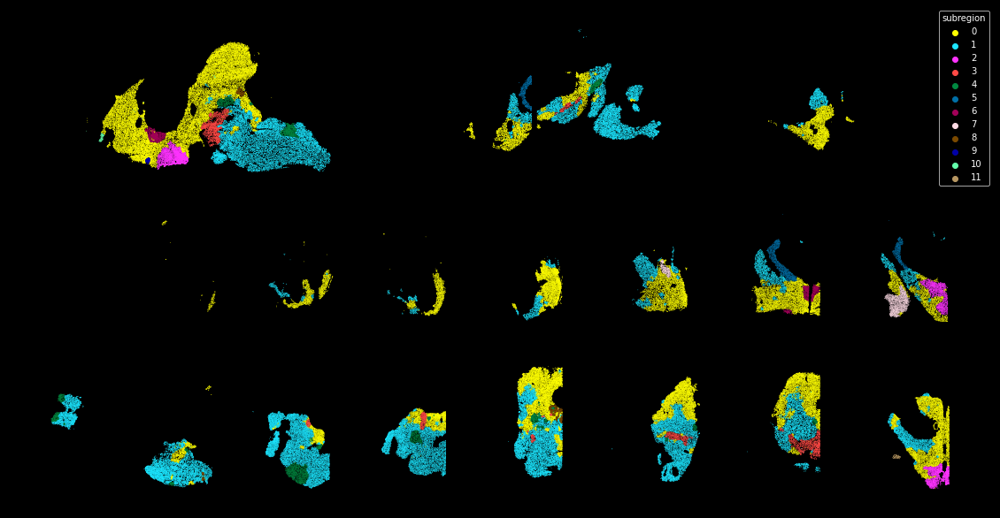

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

In [7]:
region_key = 'subregion'
regions = adata.obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102*2
cmap = {regions[i]:palette[i] for i in range(len(regions))}

spin.plot_tissue(adata, colors=adata.obs[region_key], cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)

sc.tl.rank_genes_groups(adata, groupby=region_key, use_raw=False)

subregions = adata.obs[region_key].value_counts().index # sorted by number of cells
num_markers = 10
markers = np.zeros((len(subregions),num_markers), dtype=object)

for j in range(len(subregions)):
    top_markers = sc.get.rank_genes_groups_df(adata, group=[subregions[j]])['names'][:num_markers].values
    markers[j] = top_markers

marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
marker_df.index.name = 'subregion'
marker_df.to_csv('/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/topregion1_markers.csv')

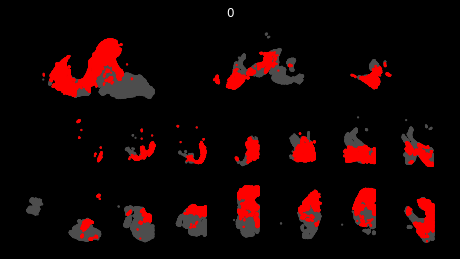

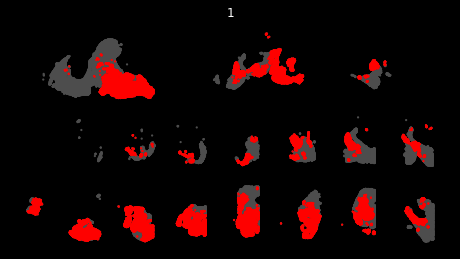

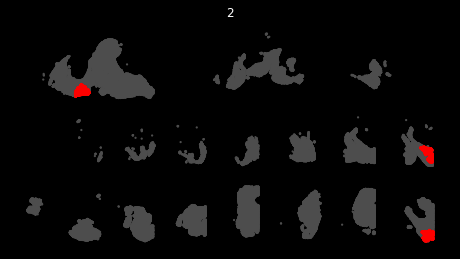

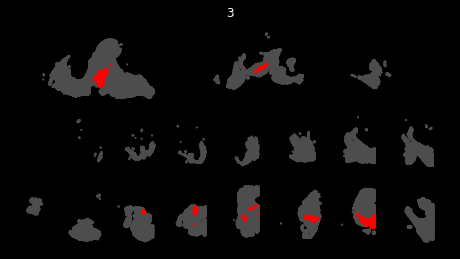

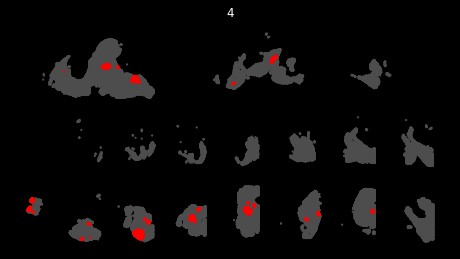

...

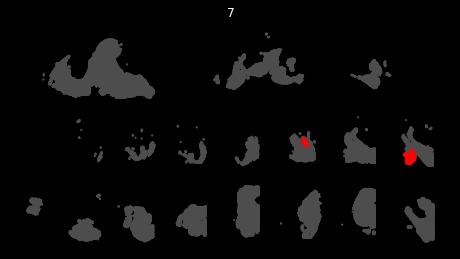

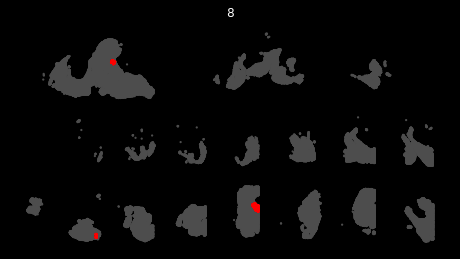

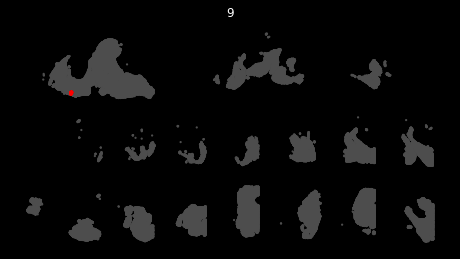

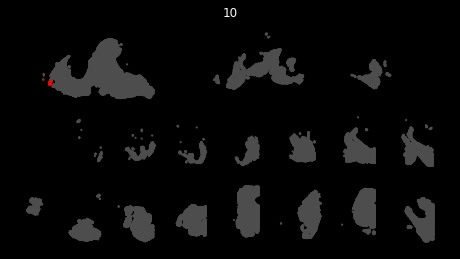

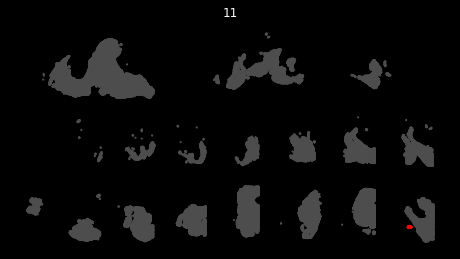

In [15]:
for region in adata.obs[region_key].value_counts().index:
    spin.plot_regions_tissue(adata, [region], region_key, title=region)

# Recluster 3rd level regions

## 60 nbrs

In [38]:
region_key = 'subsubregion'
num_nbrs = 60

ress = [
    0.3, # 0
    0.3, # 1
    0.1, # 2
    0.1, # 3
    0.2, # 4
    0.0, # 5
    0.0, # 6
    0.0, # 7
    0.0, # 8
    0.0, # 9
    0.0, # 10
    0.0, # 11
]

subdatas = []
for i in range(len(ress)):
    print(i, flush=True)
    subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
    sc.tl.leiden(subdata, resolution=ress[i], neighbors_key=region_key, key_added=region_key)
    subdatas.append(subdata)

    # sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

    # subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
    # num_markers = 10
    # markers = np.zeros((len(subregions),num_markers), dtype=object)

    # for j in range(len(subregions)):
    #     top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
    #     markers[j] = top_markers

    # marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
    # marker_df.index.name = f'subregion {i}'
    # marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}_markers.csv')

adata = sc.concat(subdatas)
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

0
1
2
3
4
5
6
7
8
9
10
11


## Variable nbrs

In [13]:
region_key = 'subsubregion'

ress = {
    '0': 0.3, # 0
    '1': 0.7, # 1
    '2': 0.2, # 3
    '3': 0.2, # 2
    '4': 0.3, # 4
    '5': 0.0, # 6
    '6': 0.0, # 5
    '7': 0.0, # 7
    '8': 0.1, # 8
    '9': 0.0, # 9
    '10': 0.0, # 10
    '11': 0.0, # 11
}

num_nbrss = {
    '0': 60, # 0
    '1': 60, # 1
    '2': 20, # 3
    '3': 20, # 2
    '4': 60, # 4
    '5': 20, # 6
    '6': 20, # 5
    '7': 20, # 7
    '8': 20, # 8
    '9': 20, # 9
    '10': 60, # 10
    '11': 60, # 11
}

subdatas = []
for i in range(len(ress)):
    num_nbrs = num_nbrss[str(i)]
    print(i, flush=True)
    subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
    sc.tl.leiden(subdata, resolution=ress[str(i)], neighbors_key=region_key, key_added=region_key)
    subdatas.append(subdata)

    sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

    subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
    num_markers = 10
    markers = np.zeros((len(subregions),num_markers), dtype=object)

    for j in range(len(subregions)):
        top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
        markers[j] = top_markers

    marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
    marker_df.index.name = f'subregion {i}'
    marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/topregion1_subregion{i}_markers.csv')

adata = sc.concat(subdatas)
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

0


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

1


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

2
3


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

4


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

5
6


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: Mean of empty slice.
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)


7


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: Mean of empty slice.
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)


8


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: Mean of empty slice.
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)


9


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


10


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: Mean of empty slice.
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarn

11


/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: Mean of empty slice.
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)


In [14]:
adata.write('/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/topregion1_subclustered_20220920.h5ad')

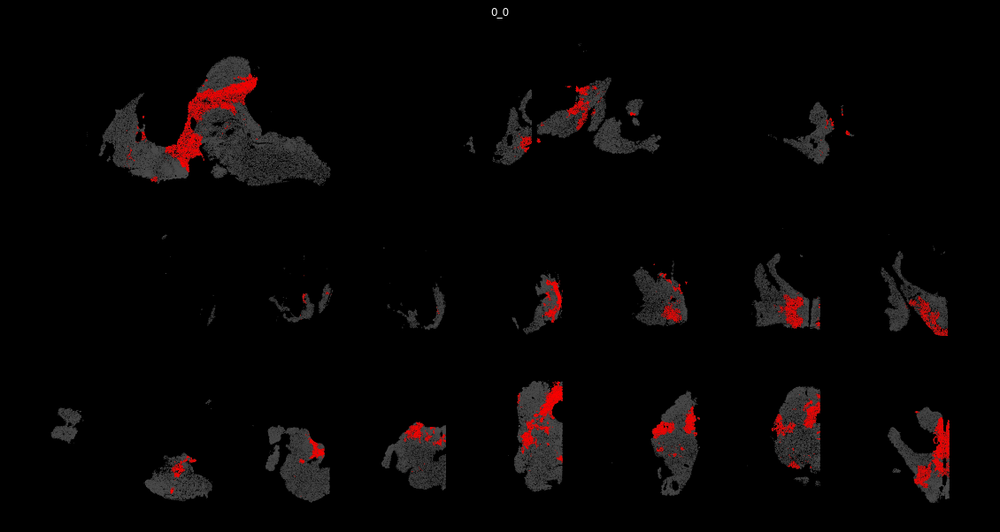

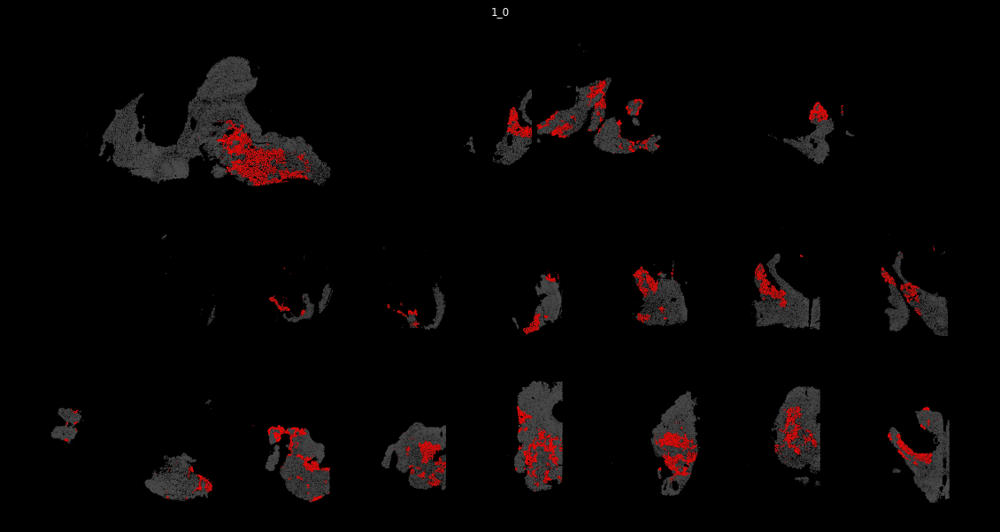

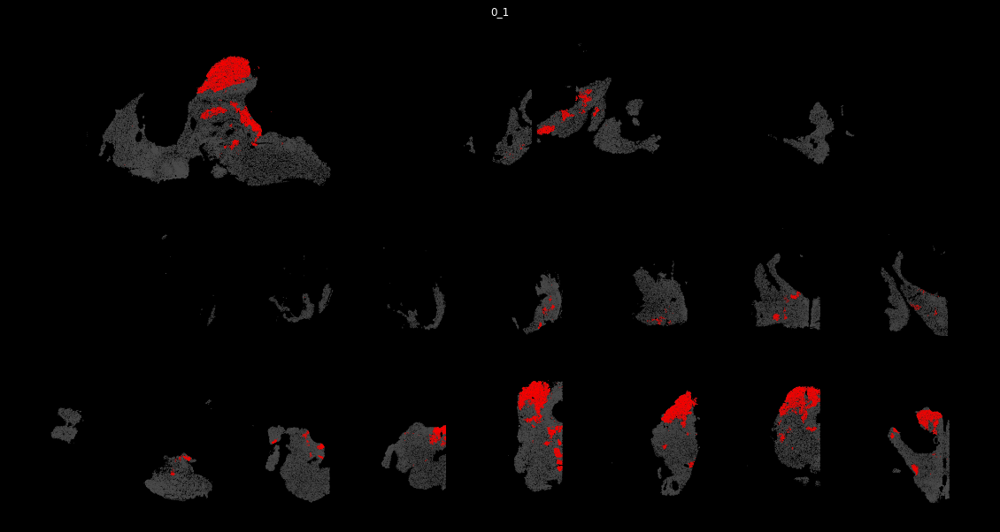

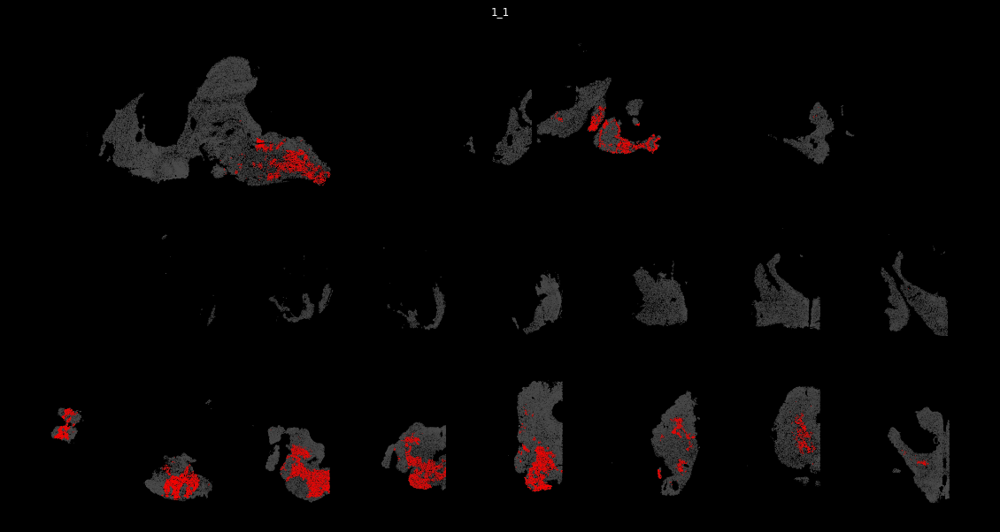

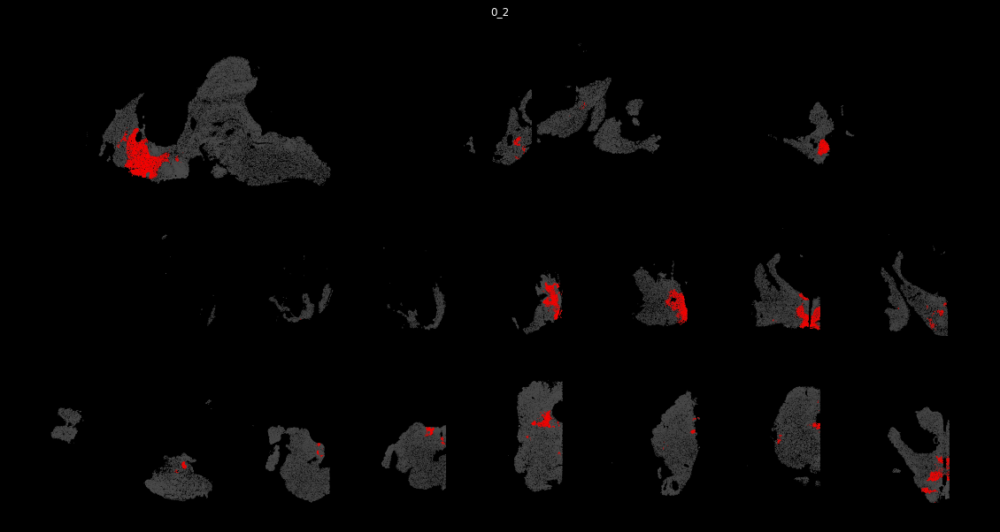

...

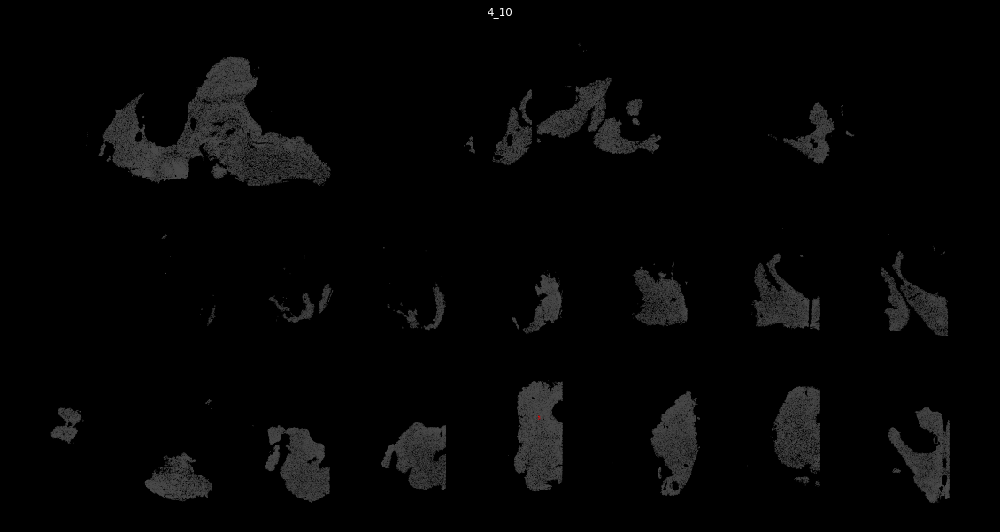

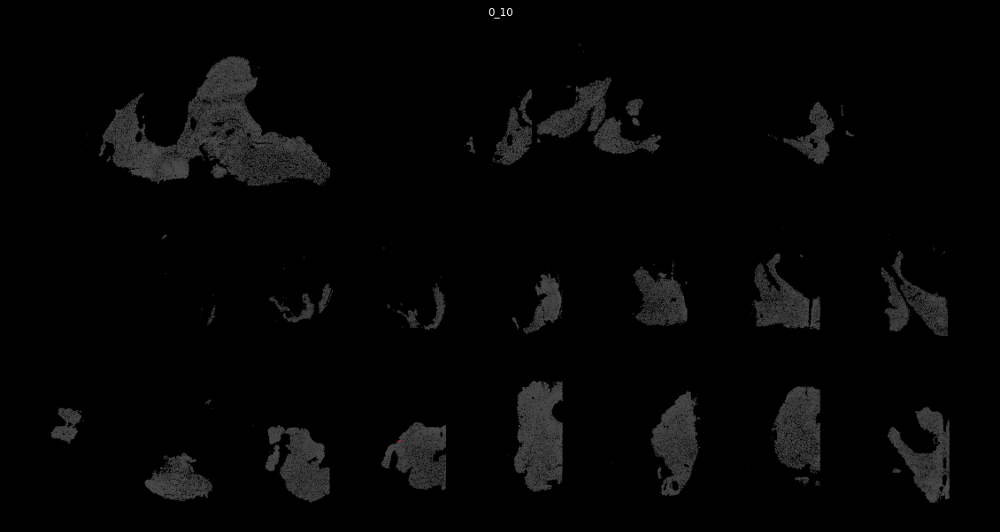

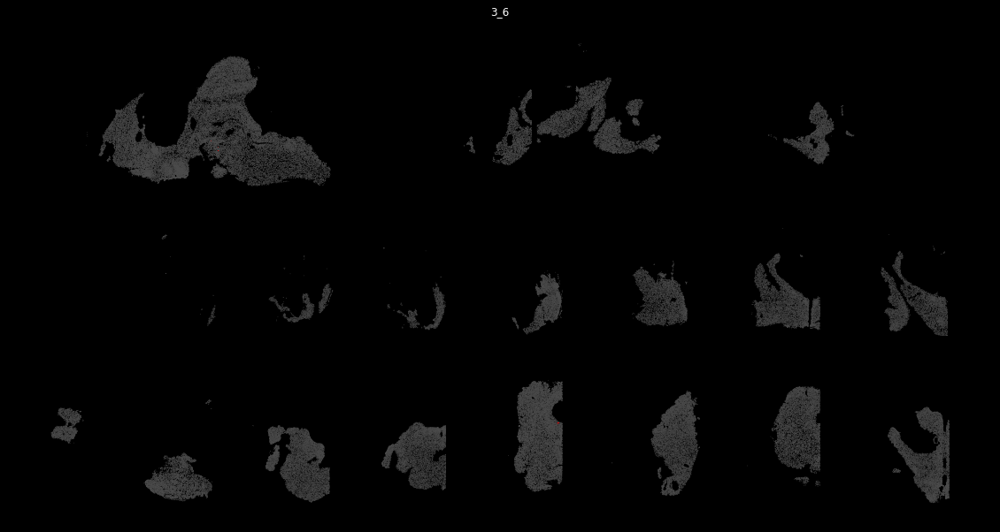

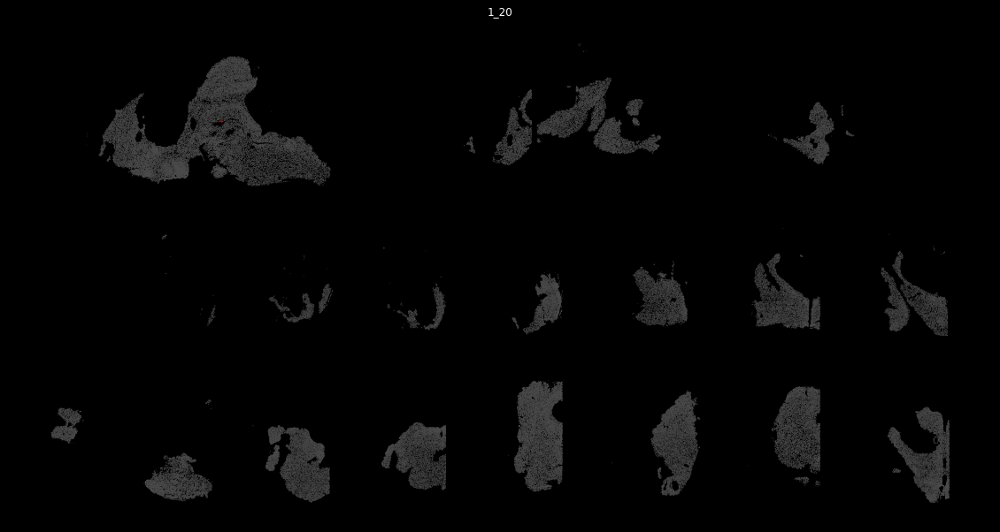

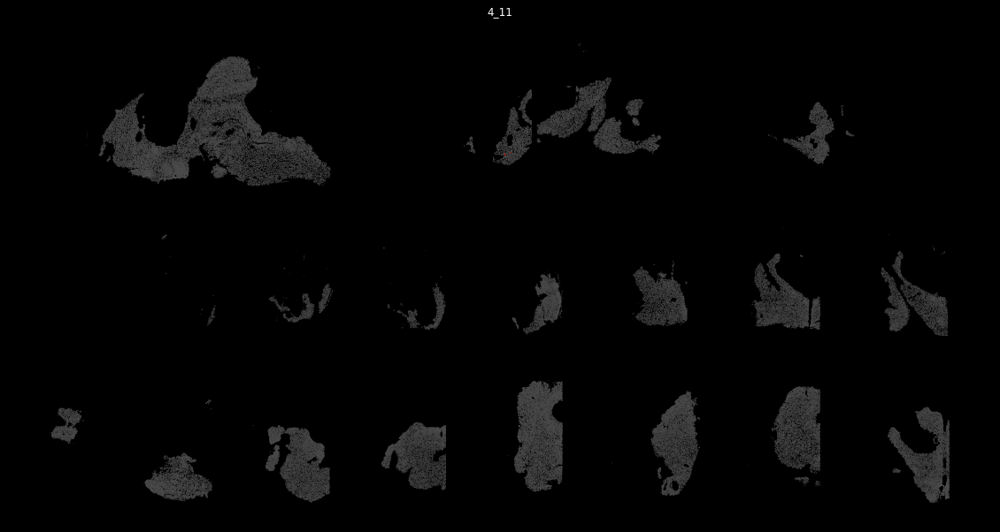

In [15]:
region_key = 'subsubregion'
for region in adata.obs[region_key].value_counts().index:
    spin.plot_regions_tissue(adata, [region], region_key, title=region, figscale=20, s=0.5, dpi=200,
                             path=f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/{region}.png')

/stanley/WangLab/kamal/code/integration/spatial/spin.py:257: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(path, bbox_inches='tight', dpi=dpi, transparent=True)
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


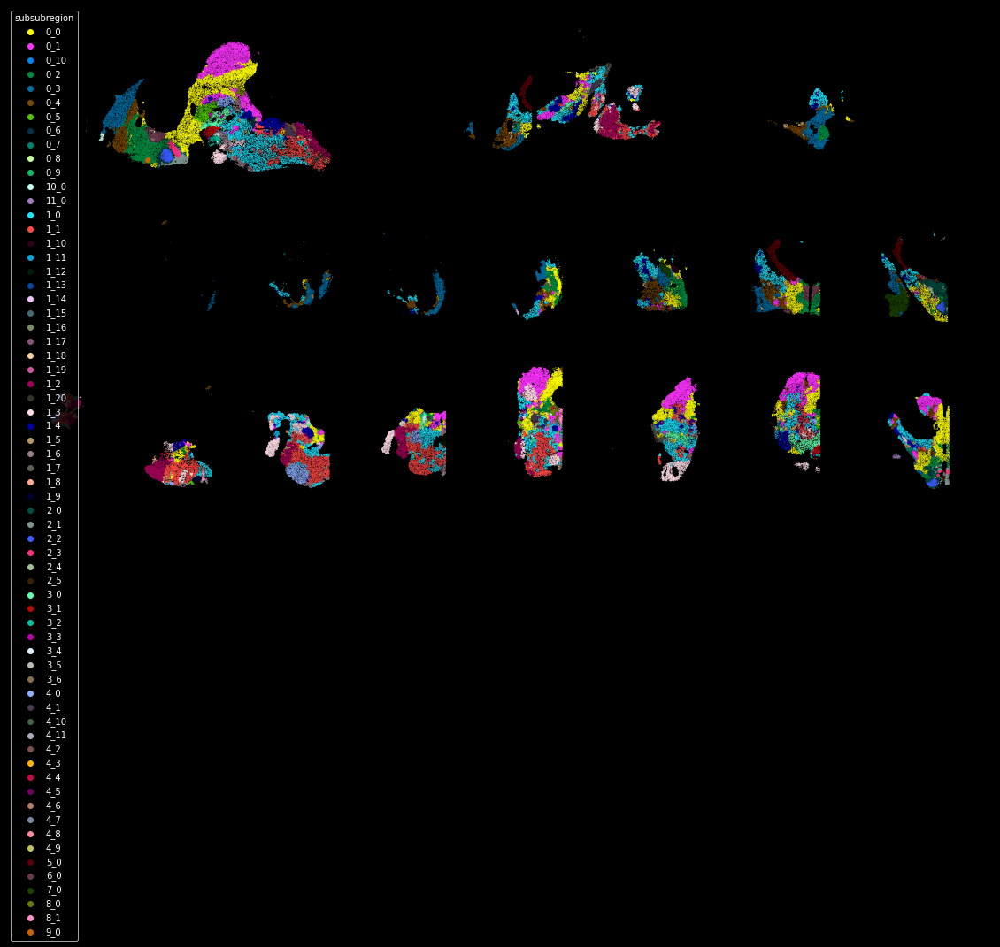

In [16]:
region_key = 'subsubregion'
regions = adata.obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {regions[i]:palette[i] for i in range(len(regions))}

tissue_path = '/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/topregion1_all_subregions.png'
spin.plot_tissue(adata, colors=adata.obs[region_key], cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)

In [4]:
backup = adata.copy()

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

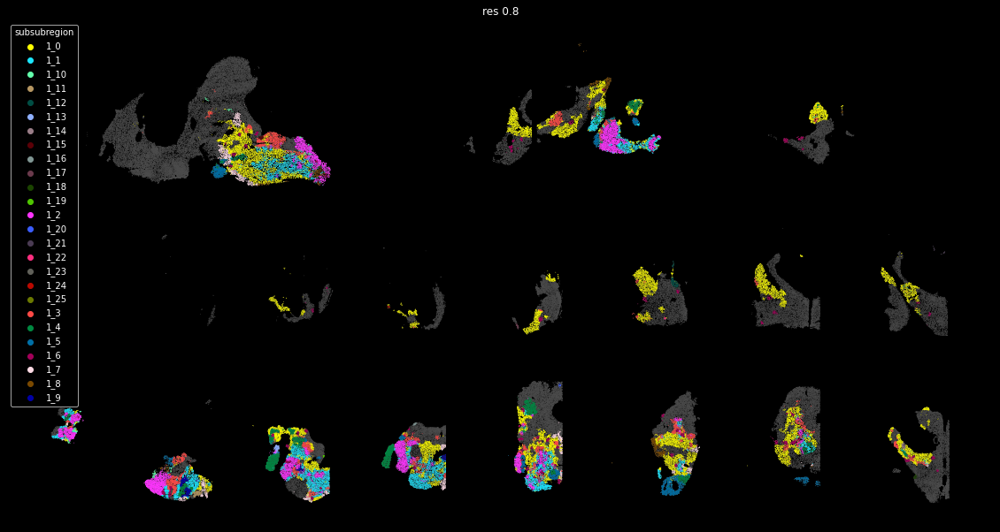

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


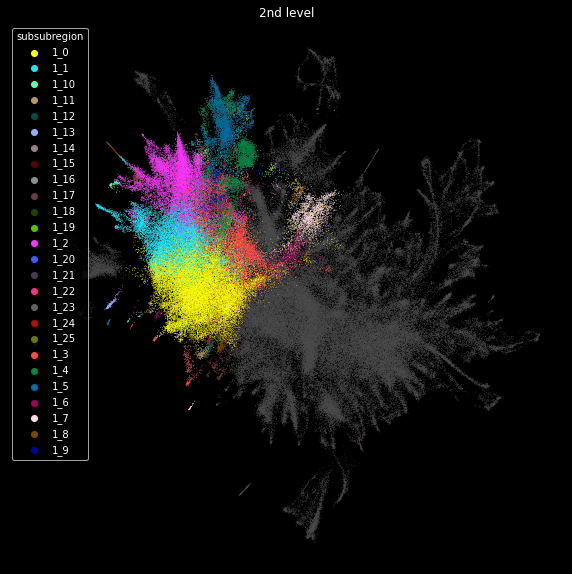

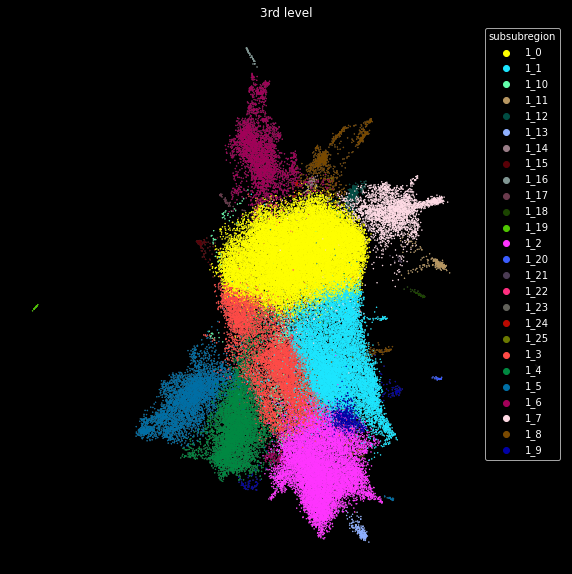

In [9]:
i = 1

res = 0.8

num_nbrs = 60

region_key = 'subsubregion'
subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
sc.tl.leiden(subdata, resolution=res, neighbors_key=region_key, key_added=region_key)

adata = sc.concat([backup[backup.obs['subregion']!=str(i)], subdata])
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

# Marker genes
sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
num_markers = 10
markers = np.zeros((len(subregions),num_markers), dtype=object)

for j in range(len(subregions)):
    top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
    markers[j] = top_markers

marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
marker_df.index.name = f'subregion {i}'
marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}_markers_res08.csv')

# Plot
region_key = 'subsubregion'
subregion = str(i)
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True, title=f'res {res}')
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=2, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldc

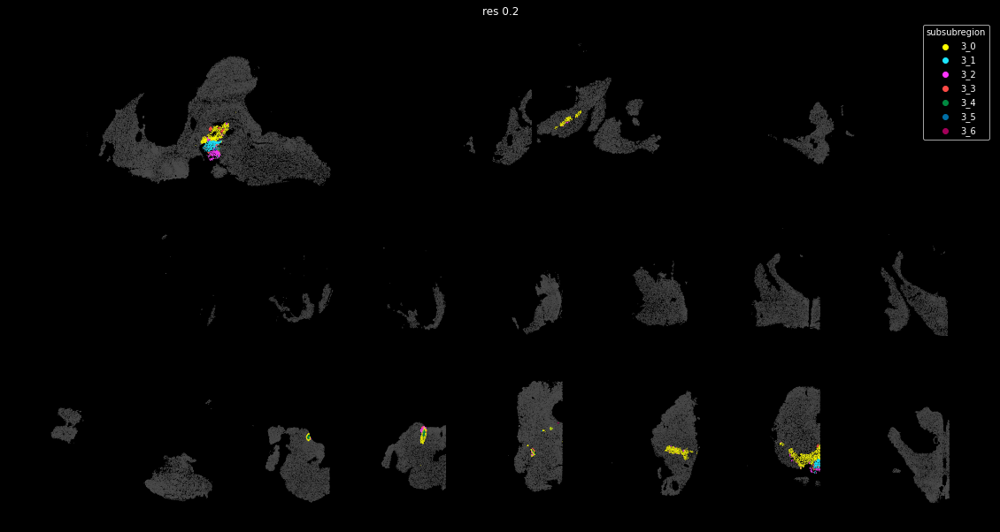

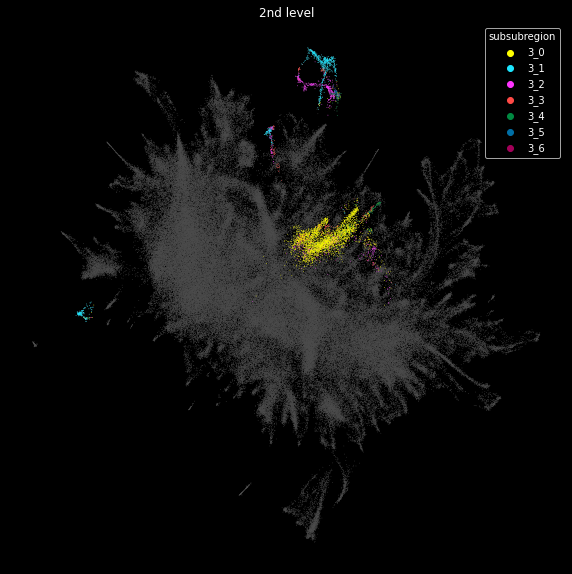

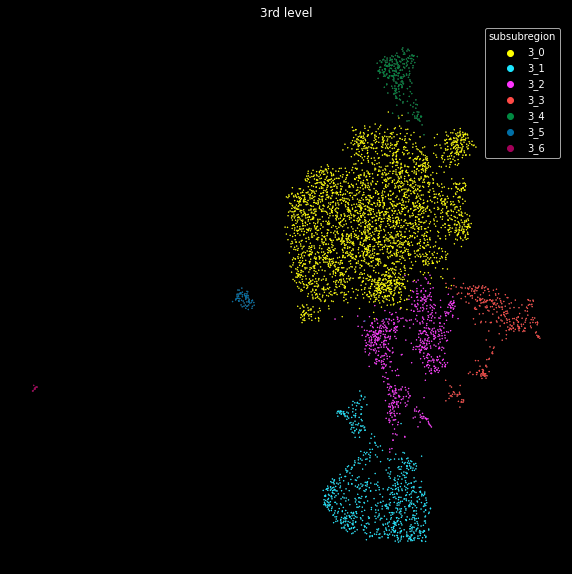

In [10]:
i = 3

res = 0.2

num_nbrs = 20

region_key = 'subsubregion'
subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
sc.tl.leiden(subdata, resolution=res, neighbors_key=region_key, key_added=region_key)

adata = sc.concat([backup[backup.obs['subregion']!=str(i)], subdata])
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

# Marker genes
sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
num_markers = 10
markers = np.zeros((len(subregions),num_markers), dtype=object)

for j in range(len(subregions)):
    top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
    markers[j] = top_markers

marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
marker_df.index.name = f'subregion {i}'
marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}_markers_res02.csv')

# Plot
region_key = 'subsubregion'
subregion = str(i)
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True, title=f'res {res}')
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=2, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

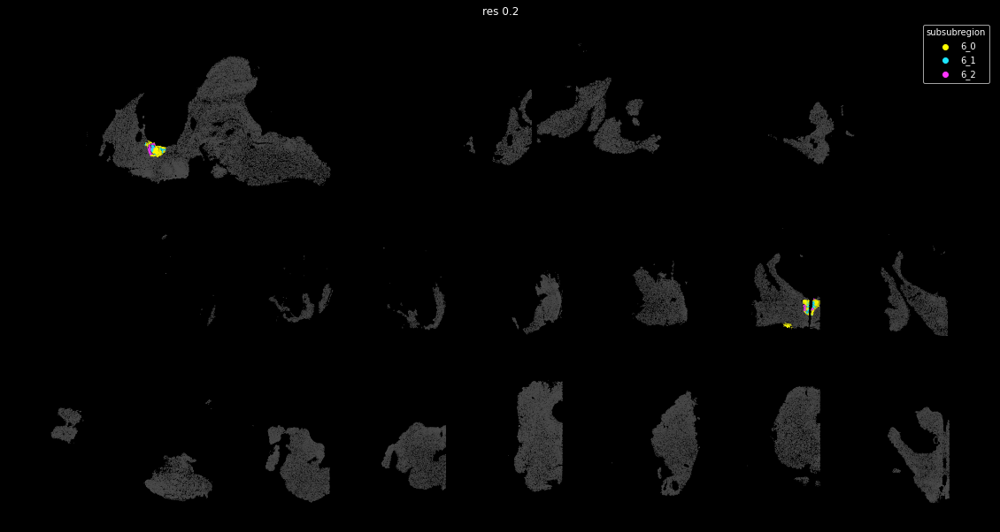

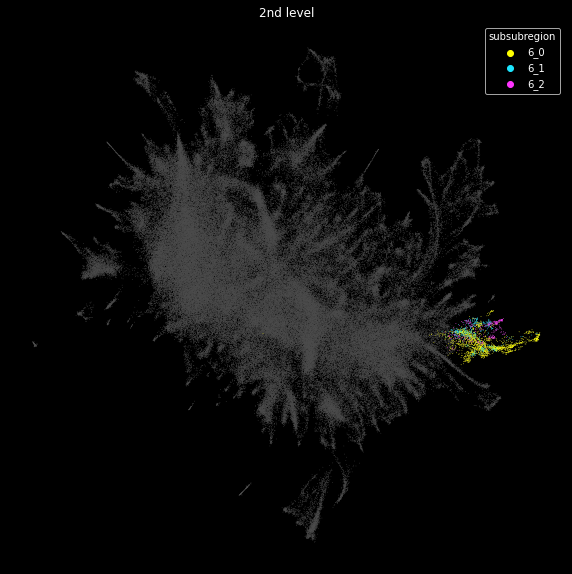

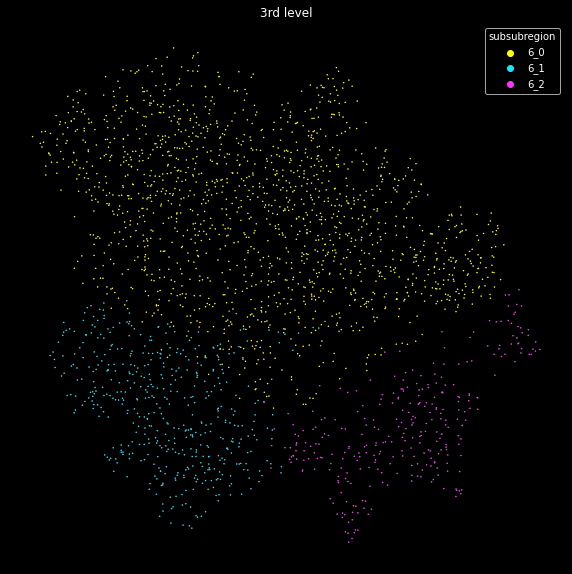

In [12]:
i = 6

res = 0.2

num_nbrs = 20

region_key = 'subsubregion'
subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
sc.tl.leiden(subdata, resolution=res, neighbors_key=region_key, key_added=region_key)

adata = sc.concat([backup[backup.obs['subregion']!=str(i)], subdata])
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

# Marker genes
# sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

# subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
# num_markers = 10
# markers = np.zeros((len(subregions),num_markers), dtype=object)

# for j in range(len(subregions)):
#     top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
#     markers[j] = top_markers

# marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
# marker_df.index.name = f'subregion {i}'
# marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}_markers_res02.csv')

# Plot
region_key = 'subsubregion'
subregion = str(i)
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True, title=f'res {res}')
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=2, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

## Plot all subsubregions

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


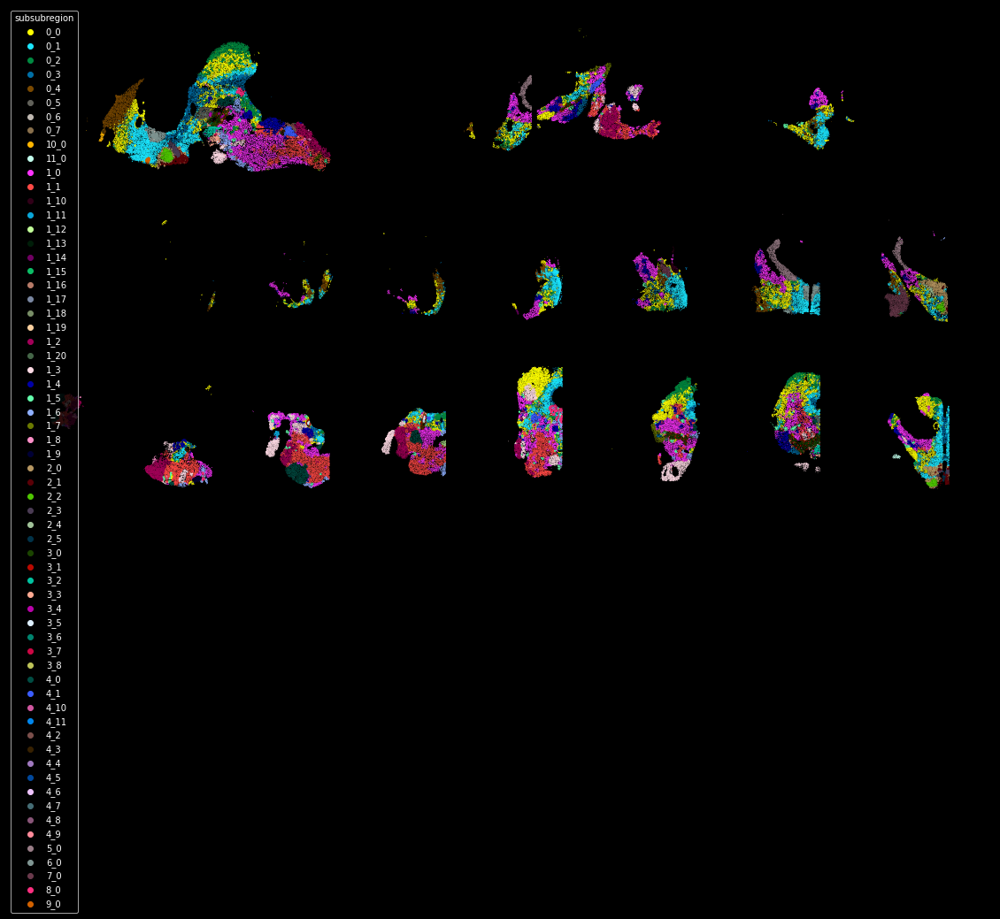

In [7]:
region_key = 'subsubregion'
regions = adata.obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102*2
cmap = {regions[i]:palette[i] for i in range(len(regions))}

spin.plot_tissue(adata, colors=adata.obs[region_key], cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)
# spin.plot_latent(adata, adata.obsm['X_umap_spin_sub'][:,0], adata.obsm['X_umap_spin_sub'][:,1],
#                     colors=adata.obs[region_key], cmap=cmap, s=0.5, legend=True, path=latent_path, dpi=dpi)

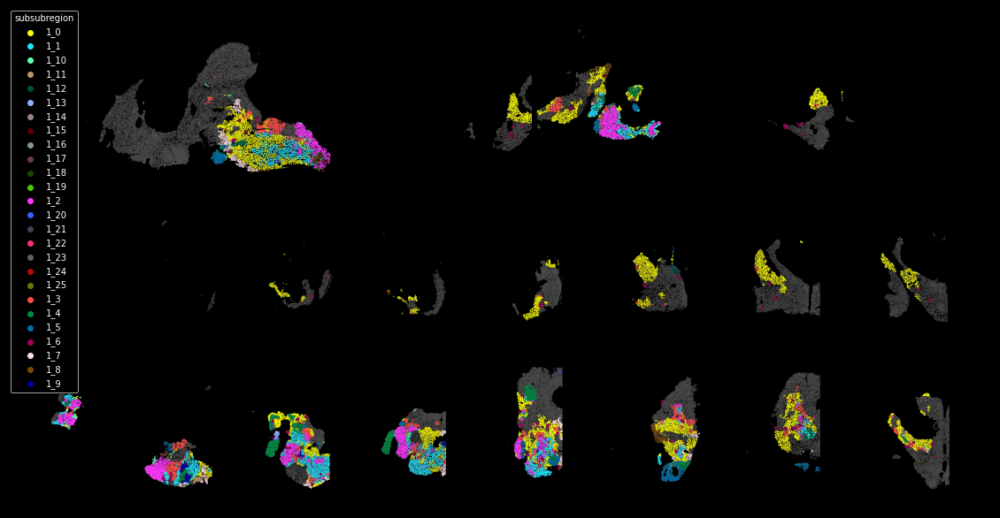

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


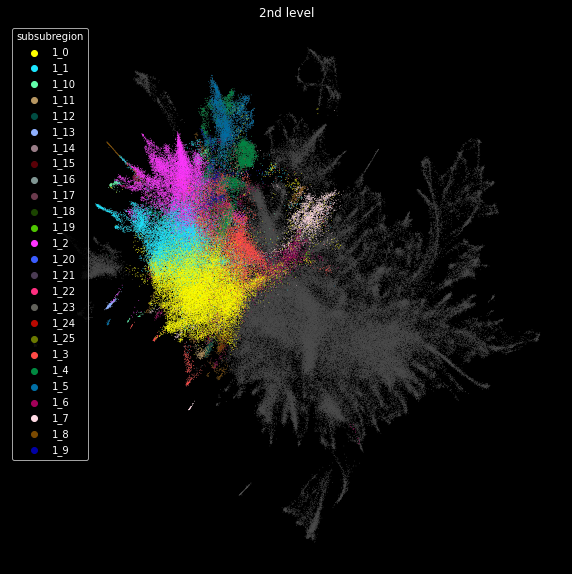

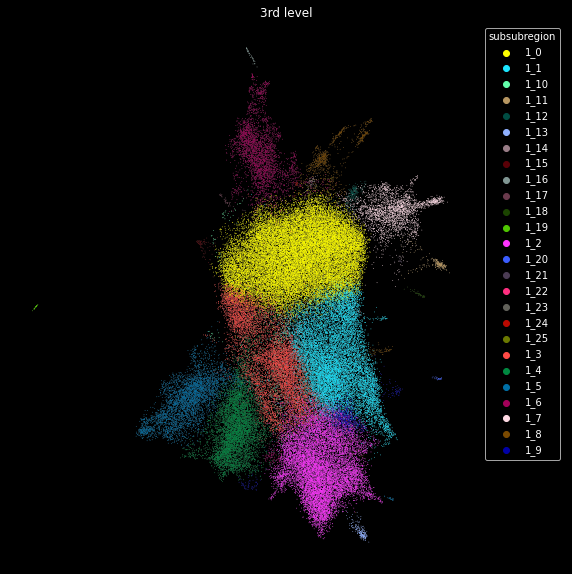

In [30]:
region_key = 'subsubregion'
subregion = '1'
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

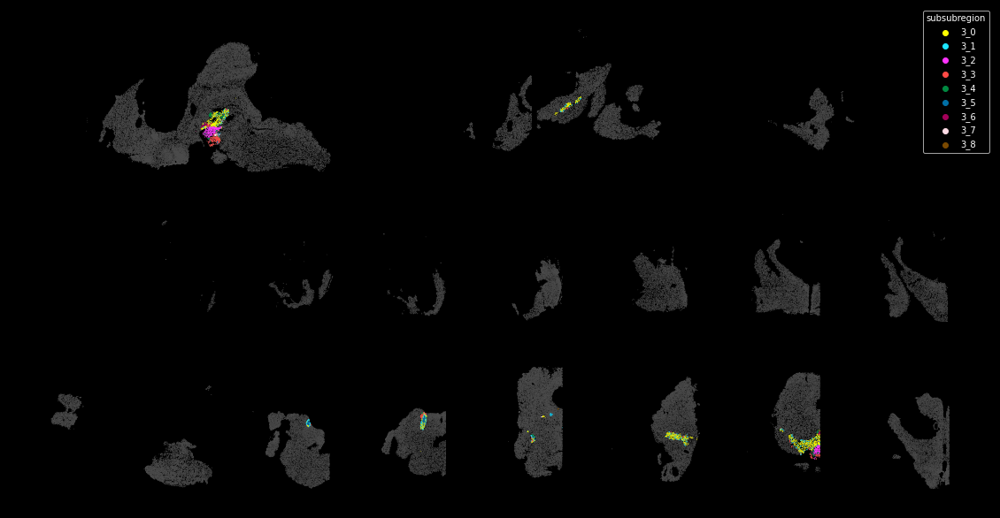

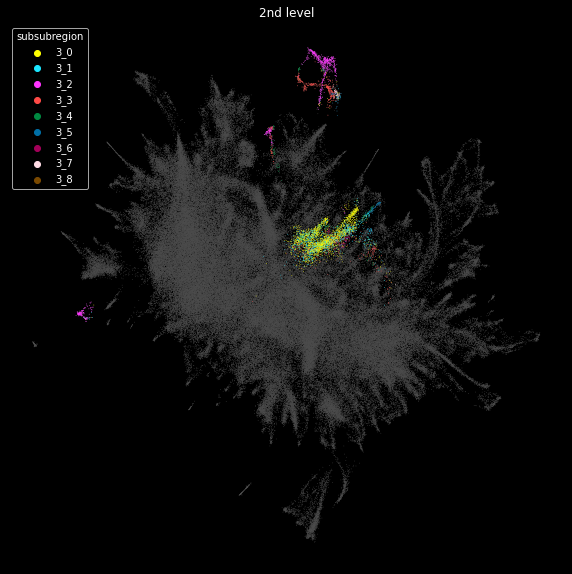

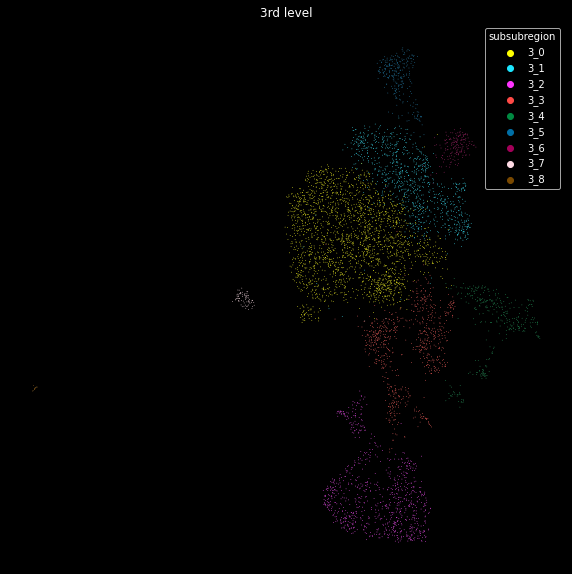

In [8]:
region_key = 'subsubregion'
subregion = '3'
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=2, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

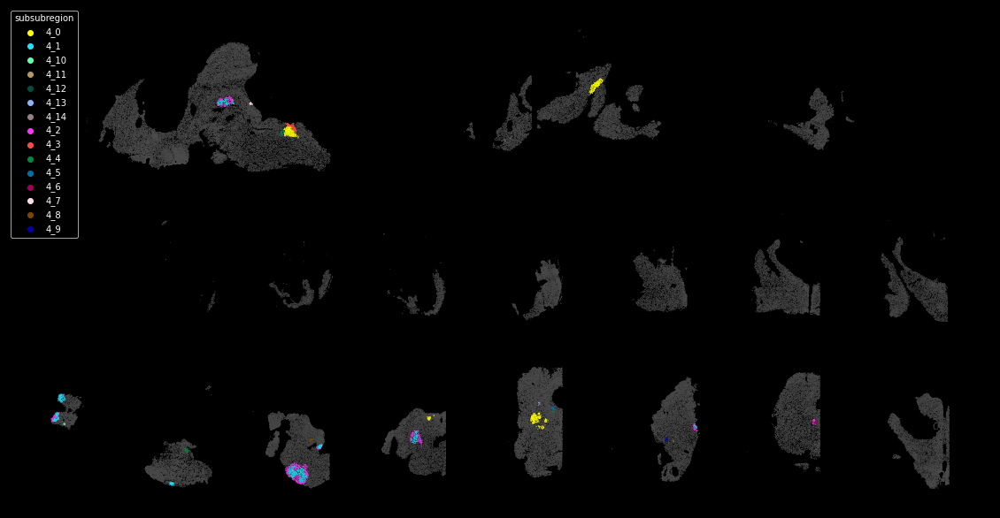

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


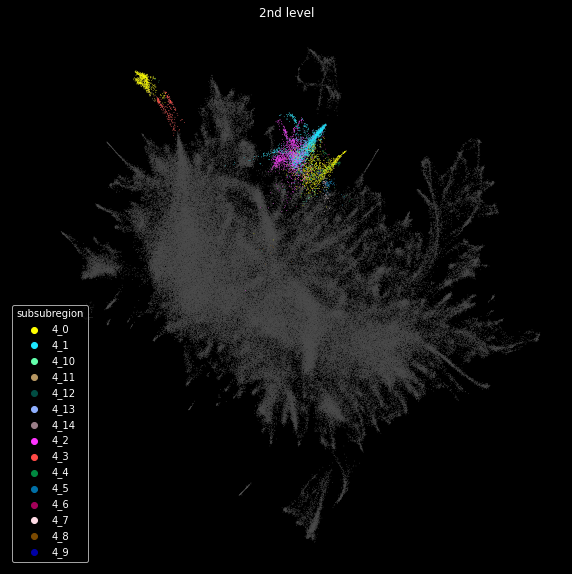

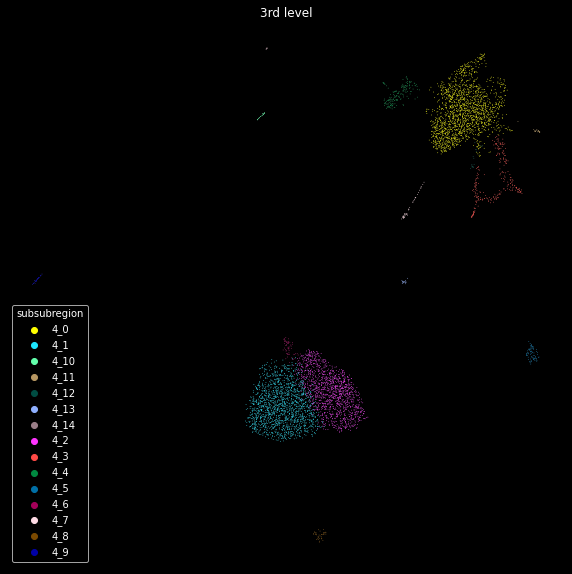

In [27]:
region_key = 'subsubregion'
subregion = '4'
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

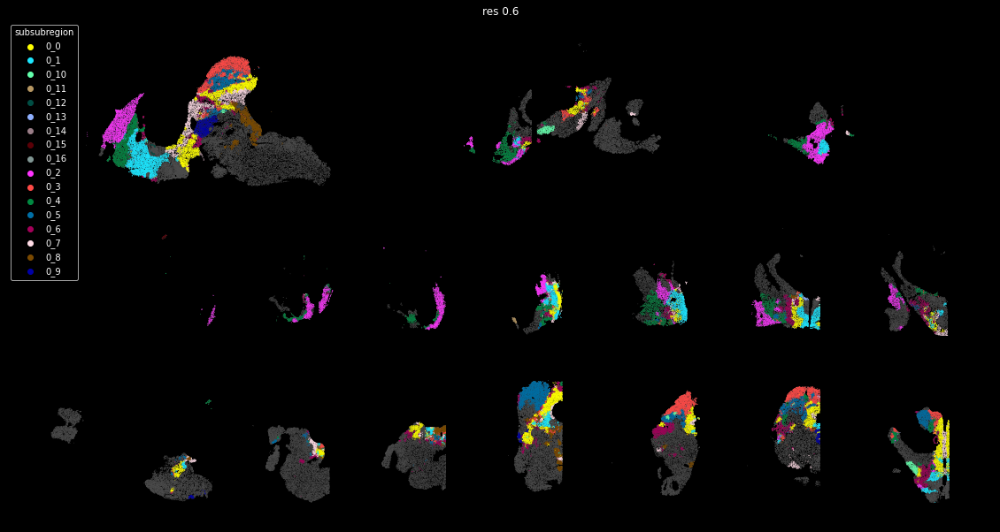

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


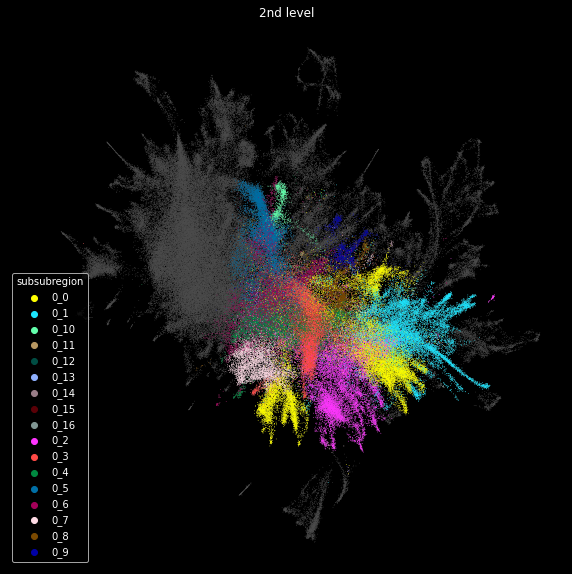

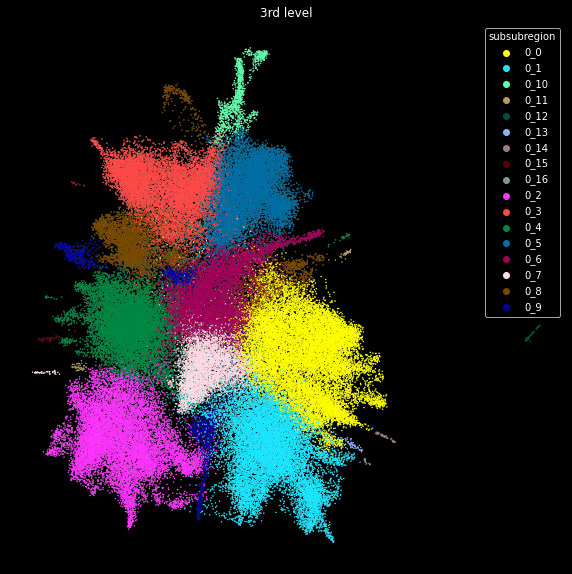

In [ ]:
i = 0

res = 0.3

num_nbrs = 60

region_key = 'subsubregion'
subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
sc.tl.leiden(subdata, resolution=res, neighbors_key=region_key, key_added=region_key)

adata = sc.concat([adata[adata.obs['subregion']!=str(i)], subdata])
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

# Marker genes
# sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

# subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
# num_markers = 10
# markers = np.zeros((len(subregions),num_markers), dtype=object)

# for j in range(len(subregions)):
#     top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
#     markers[j] = top_markers

# marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
# marker_df.index.name = f'subregion {i}'
# marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}_markers_res02.csv')

# Plot
region_key = 'subsubregion'
subregion = str(i)
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True, title=f'res {res}')
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=2, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

## Plot each subsubregion individually (for a given subregion)

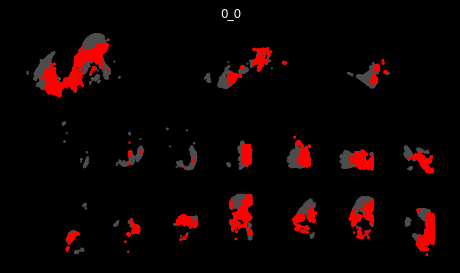

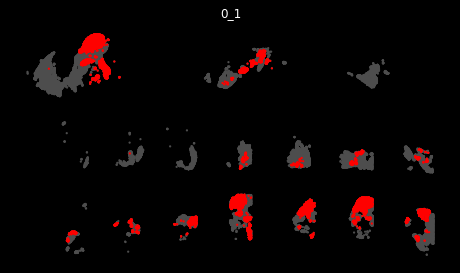

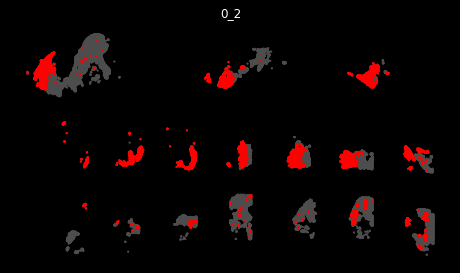

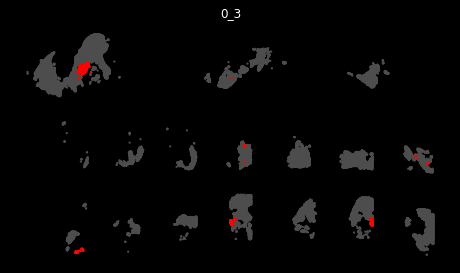

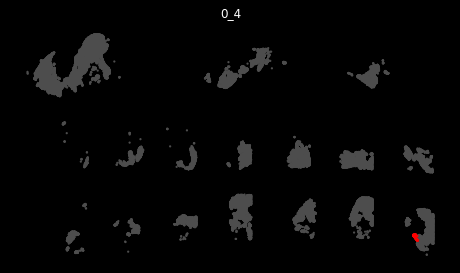

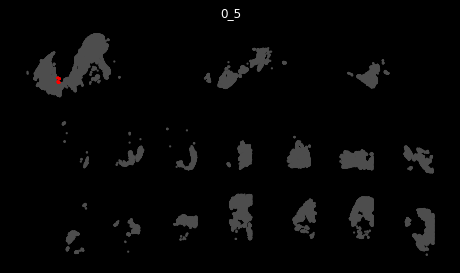

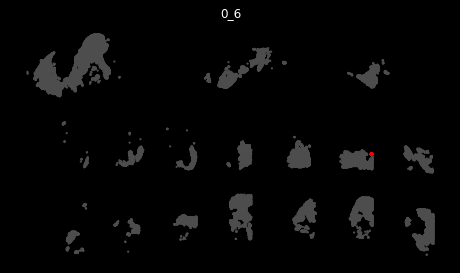

In [37]:
subregion = '0'
subdata = adata[adata.obs['subregion']==subregion]
for region in subdata.obs[region_key].value_counts().index:
    spin.plot_regions_tissue(subdata, [region], 'subsubregion', title=region)

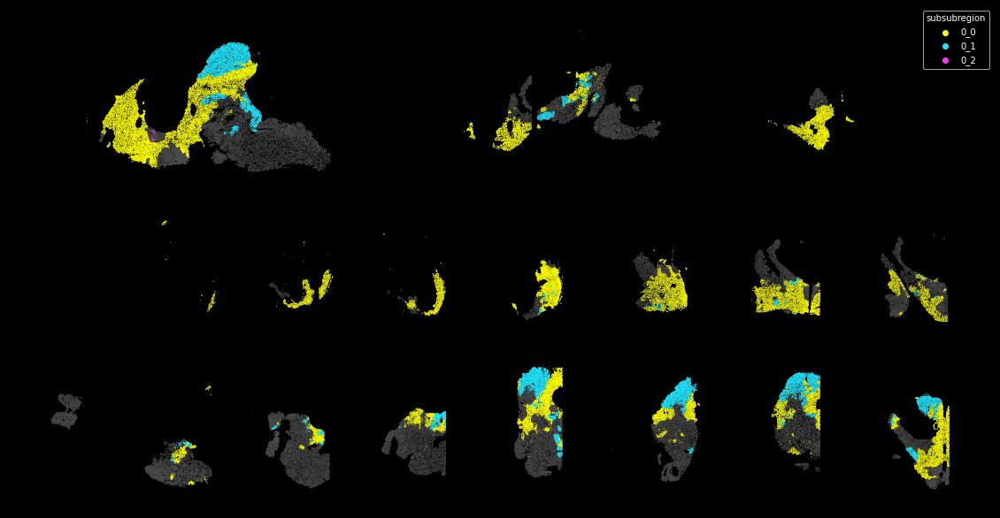

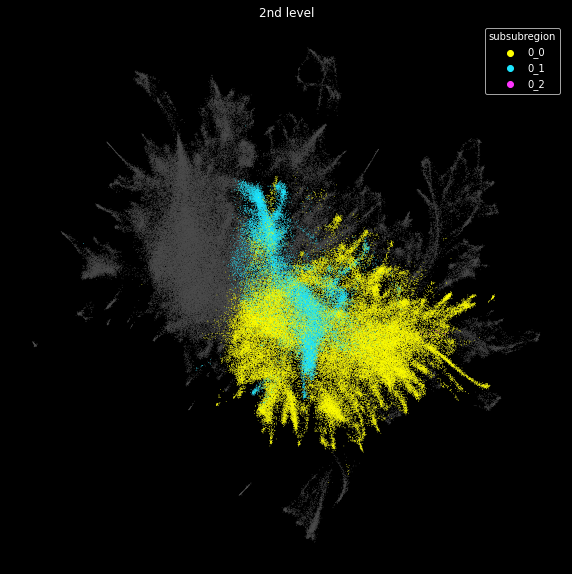

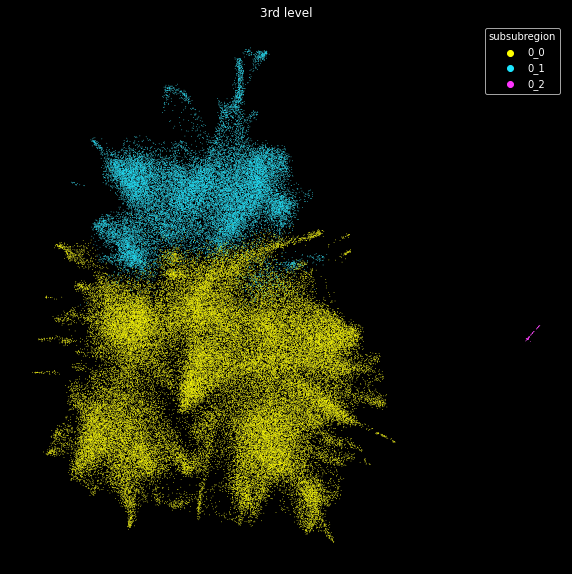

In [6]:
region_key = 'subsubregion'
subregion = '0'
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True)
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

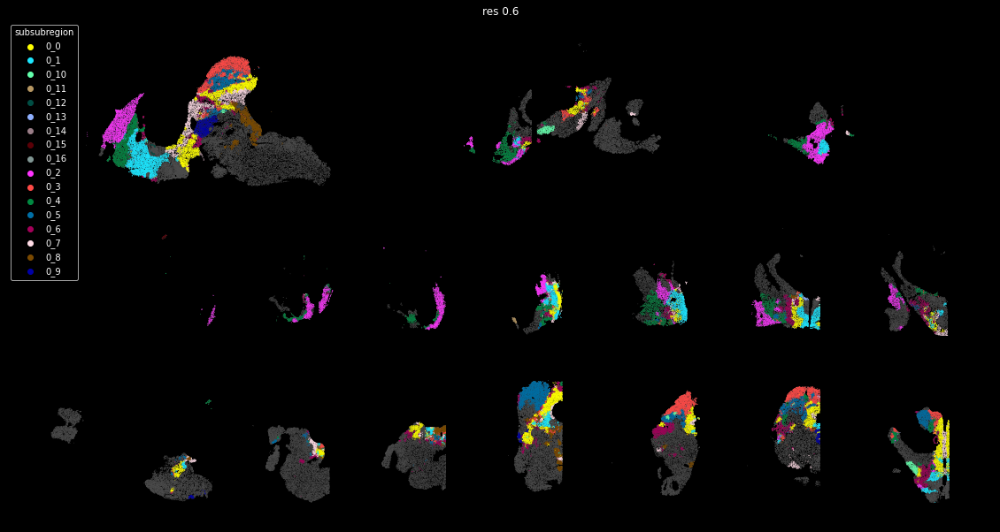

/stanley/WangLab/envs/neighbors/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


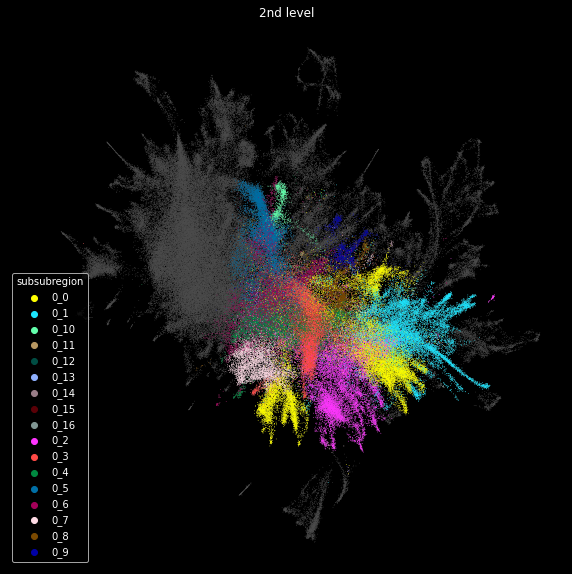

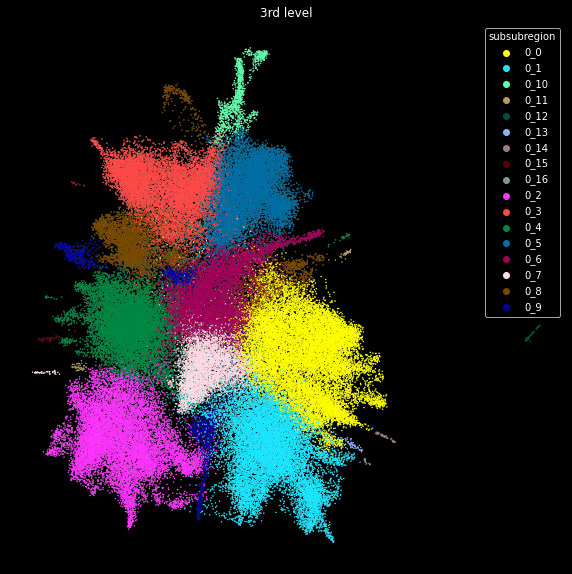

In [12]:
i = 0

res = 0.3

num_nbrs = 60

region_key = 'subsubregion'
subdata = sc.read_h5ad(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}.h5ad')
sc.tl.leiden(subdata, resolution=res, neighbors_key=region_key, key_added=region_key)

adata = sc.concat([adata[adata.obs['subregion']!=str(i)], subdata])
adata.obs[region_key] = [adata.obs['subregion'][i]+'_'+adata.obs[region_key][i] for i in range(len(adata))]
adata.obs[region_key] = adata.obs[region_key].astype('category')
adata.obs[['x','y']] = adata.obs[['row','col']]

# Marker genes
# sc.tl.rank_genes_groups(subdata, groupby=region_key, use_raw=False)

# subregions = subdata.obs[region_key].value_counts().index # sorted by number of cells
# num_markers = 10
# markers = np.zeros((len(subregions),num_markers), dtype=object)

# for j in range(len(subregions)):
#     top_markers = sc.get.rank_genes_groups_df(subdata, group=[subregions[j]])['names'][:num_markers].values
#     markers[j] = top_markers

# marker_df = pd.DataFrame(data=markers, index=subregions, columns=[f'rank{i+1}' for i in range(num_markers)])
# marker_df.index.name = f'subregion {i}'
# marker_df.to_csv(f'/stanley/WangLab/kamal/data/integrated/spatial/atlas/topregion1/subsub_nbr_titration/subregion{i}/{num_nbrs}nbrs/topregion1_subregion{i}_markers_res02.csv')

# Plot
region_key = 'subsubregion'
subregion = str(i)
subsubregions = adata[adata.obs['subregion']==subregion].obs[region_key].value_counts().index # sorted by number of cells
palette = sc.pl.palettes.default_102
cmap = {subsubregions[i]:palette[i] for i in range(len(subsubregions))}

spin.plot_regions_tissue(adata, subsubregions, region_key, cmap=cmap, s=0.5, figscale=20, path=tissue_path, dpi=dpi, legend=True, title=f'res {res}')
spin.plot_regions_latent(adata, 'X_umap_spin_sub', subsubregions, region_key, cmap=cmap, s=0.5, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='2nd level')
spin.plot_regions_latent(adata[adata.obs['subregion']==subregion], 'X_umap_spin_subsub', subsubregions, region_key, cmap=cmap, s=2, figscale=10, path=tissue_path, dpi=dpi, legend=True, title='3rd level')

# Todo

- Save markers for 1_1 at res = 0.8 (green vs blue) (60nbrs)

- Save markers for 1_3 at res 0.05 and 0.2